dict_keys(['__header__', '__version__', '__globals__', 'UALL', 'UEXTRA', 'VALL', 'VEXTRA', 'VORTALL', 'VORTEXTRA', 'm', 'n', 'nx', 'ny'])
vortices.shape =  (89351, 151)
U.shape =  (89351, 151)
S.shape =  (151,)
VT.shape =  (151, 151)
m,n =  199 449


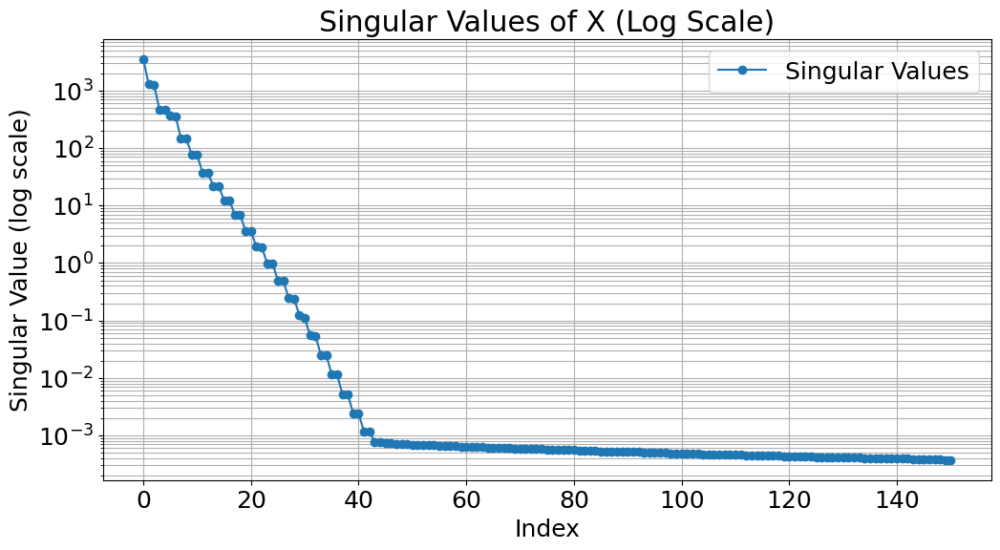

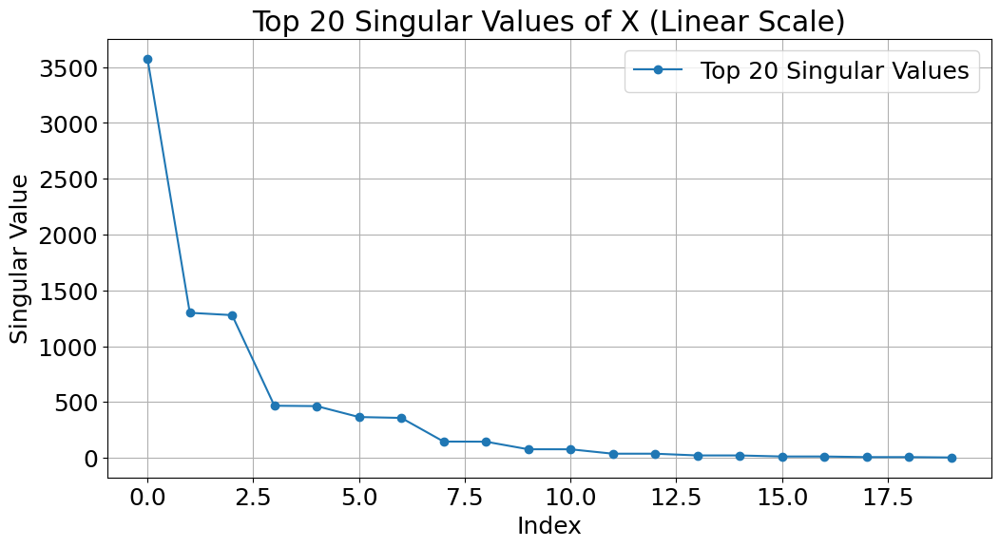

In [1]:

import matplotlib.pyplot as plt
import numpy as np
import os
import scipy.io
plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams.update({'font.size': 18})

mat_contents = scipy.io.loadmat(os.path.join('..','DATA','CYLINDER_ALL.mat'))

print(mat_contents.keys())

vortices = mat_contents['VORTALL']
m = int(np.squeeze(mat_contents['m']))
n = int(np.squeeze(mat_contents['n']))

print ("vortices.shape = ", vortices.shape  )

U,S,VT = np.linalg.svd(vortices, full_matrices=False)


plt.figure(figsize=(12, 6))
plt.subplot(1, 1, 1)
plt.semilogy(S, 'o-', label='Singular Values')  # changed from plt.plot(...)
plt.title('Singular Values of X (Log Scale)')
plt.xlabel('Index')
plt.ylabel('Singular Value (log scale)')
plt.grid(True, which='both')
plt.legend()

plt.figure(figsize=(12, 6))
plt.subplot(1, 1, 1)
plt.plot(S[:20], 'o-', label='Top 20 Singular Values')
plt.title('Top 20 Singular Values of X (Linear Scale)')
plt.xlabel('Index')
plt.ylabel('Singular Value')
plt.grid(True)
plt.legend()




print( "U.shape = ", U.shape  )
print( "S.shape = ", S.shape  )
print( "VT.shape = ", VT.shape   )
print( "m,n = ", m, n  )


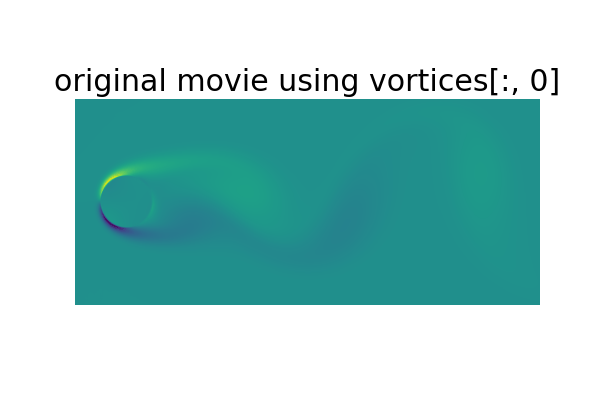

In [21]:

import matplotlib.animation as animation
from IPython.display import Image, display

m_display, n_display = 199, 449
num_frames = vortices.shape[1]  # Use all available frames
fps = 23
output_path = 'vortices.gif'

u_subset = vortices[:, :num_frames]
u_min = u_subset.min()
u_max = u_subset.max()

fig, ax = plt.subplots(figsize=(6, 4))
frame0 = u_subset[:, 0].reshape((m_display, n_display), order='F')
im = ax.imshow(frame0, cmap='viridis', vmin=u_min, vmax=u_max)
ax.set_title('original movie using vortices[:, 0]')
ax.axis('off')

def update(frame_idx):
    frame = u_subset[:, frame_idx].reshape((m_display, n_display), order='F')
    im.set_data(frame)
    ax.set_title(f'original movie using vortices[:, {frame_idx}]')
    return (im,)

anim = animation.FuncAnimation(fig, update, frames=num_frames, interval=1000 / fps, blit=True)
anim.save(output_path, writer='pillow', fps=fps)
plt.close(fig)

display(Image(filename=output_path))


In [3]:
# Energy captured by rank-r truncation uses sigma^2
energy = S**2
total_energy = np.sum(energy)
cumulative_energy_ratio = np.cumsum(energy) / total_energy

targets = [0.90, 0.99, 0.999, 0.9999]
r_values = []

for target in targets:
    r = np.searchsorted(cumulative_energy_ratio, target) + 1
    r_values.append(r)
    captured = cumulative_energy_ratio[r - 1]
    print(f"Target {target*100:>5.1f}% -> r = {r:>3d}, captured = {captured*100:6.3f}%")


Target  90.0% -> r =   3, captured = 95.532%
Target  99.0% -> r =   7, captured = 99.654%
Target  99.9% -> r =   9, captured = 99.905%
Target 100.0% -> r =  13, captured = 99.992%


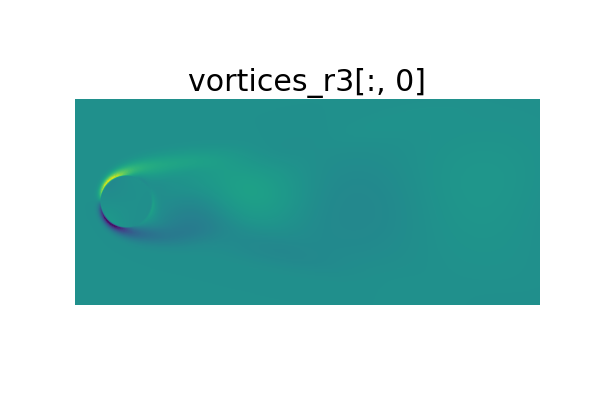

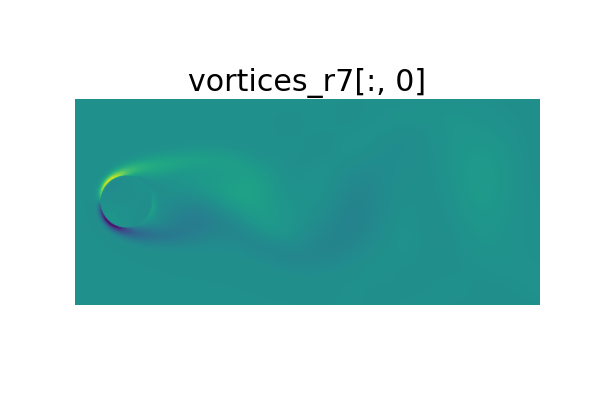

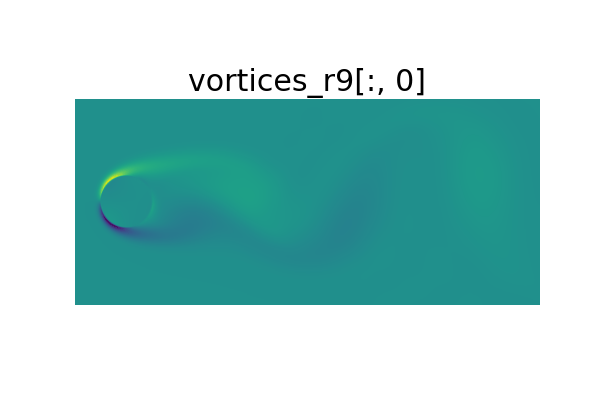

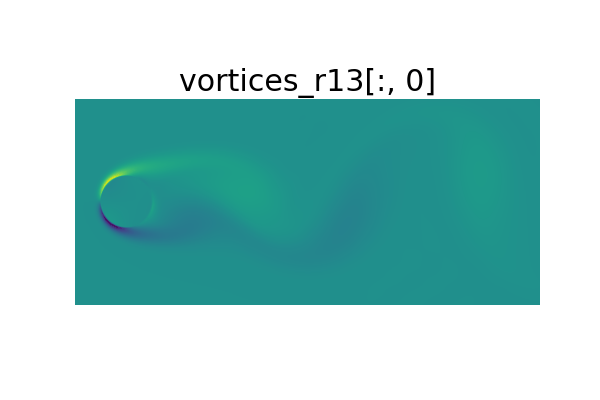

In [4]:
import matplotlib.animation as animation
from IPython.display import Image, display

m_display, n_display = 199, 449
num_frames = vortices.shape[1]
fps = 23

def make_vortices_movie(X, r_label):
    output_path = f'vortices_r{r_label}.gif'
    x_min = X.min()
    x_max = X.max()

    fig, ax = plt.subplots(figsize=(6, 4))
    frame0 = X[:, 0].reshape((m_display, n_display), order='F')
    im = ax.imshow(frame0, cmap='viridis', vmin=x_min, vmax=x_max)
    ax.set_title(f'vortices_r{r_label}[:, 0]')
    ax.axis('off')

    def update(frame_idx):
        frame = X[:, frame_idx].reshape((m_display, n_display), order='F')
        im.set_data(frame)
        ax.set_title(f'vortices_r{r_label}[:, {frame_idx}]')
        return (im,)

    anim = animation.FuncAnimation(fig, update, frames=num_frames, interval=1000 / fps, blit=True)
    anim.save(output_path, writer='pillow', fps=fps)
    plt.close(fig)
    display(Image(filename=output_path))

for r in r_values:
    Xr = (U[:, :r] * S[:r]) @ VT[:r, :]
    make_vortices_movie(Xr, r)


r =   3 -> ||X - Xr||_F^2 = 7.533580e+05
r =   7 -> ||X - Xr||_F^2 = 5.842190e+04
r =   9 -> ||X - Xr||_F^2 = 1.604567e+04
r =  13 -> ||X - Xr||_F^2 = 1.388045e+03


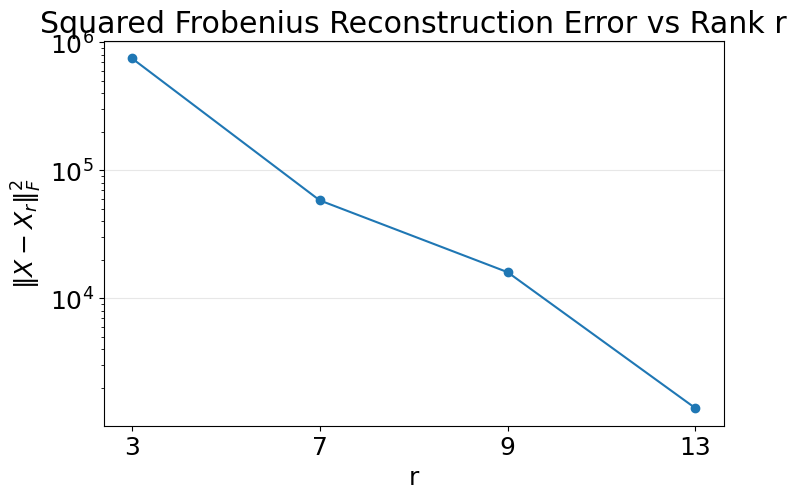

In [5]:
# Squared Frobenius norm error: ||vortices - X_r||_F^2 for each r in r_values
fro_errors_sq = []

for r in r_values:
    Xr = (U[:, :r] * S[:r]) @ VT[:r, :]
    err_sq = np.linalg.norm(vortices - Xr, ord='fro')**2
    fro_errors_sq.append(err_sq)

# Print numeric values
for r, e in zip(r_values, fro_errors_sq):
    print(f"r = {r:>3d} -> ||X - Xr||_F^2 = {e:.6e}")

# Bar chart
plt.figure(figsize=(8, 5))
#plt.bar([str(r) for r in r_values], fro_errors_sq)
plt.semilogy([str(r) for r in r_values], fro_errors_sq, 'o-', label='Squared Frobenius Error')  # Log scale for better visibility
plt.xlabel('r')
plt.ylabel(r'$\|X - X_r\|_F^2$')
plt.title('Squared Frobenius Reconstruction Error vs Rank r')
plt.grid(axis='y', alpha=0.3)
plt.show()

In [6]:
# Fix rank
r = 10

# Truncated SVD components
U_tilde = U[:, :r]          # shape: (m, r)
S_tilde = S[:r]             # shape: (r,)
V_tilde_T = VT[:r, :]       # shape: (r, n)

# W = S_tilde * V_tilde_T  (broadcast scales each row of V_tilde_T by singular value)
W = S_tilde[:, None] * V_tilde_T   # shape: (r, n)

# For each column w_k in W, compute x_hat_k = U_tilde @ w_k
# Then compare x_hat_k with original vortices[:, k]
diff_norms = []
cos_sims = []

for k in range(vortices.shape[1]):
    w_k = W[:, k]                    # shape: (r,)
    x_hat_k = U_tilde @ w_k          # reconstructed column, shape: (m,)
    x_k = vortices[:, k]             # original column, shape: (m,)

    diff_norm = np.linalg.norm(x_k - x_hat_k)
    denom = np.linalg.norm(x_k) * np.linalg.norm(x_hat_k)
    cos_sim = np.dot(x_k, x_hat_k) / denom if denom > 0 else 0.0

    diff_norms.append(diff_norm)
    cos_sims.append(cos_sim)

diff_norms = np.array(diff_norms)
cos_sims = np.array(cos_sims)

print(f"r = {r}")
print("Shapes:")
print("U_tilde:", U_tilde.shape)
print("S_tilde:", S_tilde.shape)
print("V_tilde_T:", V_tilde_T.shape)
print("W:", W.shape)

print("\nPer-column comparison summary (x_hat_k vs vortices[:,k]):")
print(f"Diff norm   -> min: {diff_norms.min():.6e}, mean: {diff_norms.mean():.6e}, max: {diff_norms.max():.6e}")
print(f"Cosine sim  -> min: {cos_sims.min():.6f}, mean: {cos_sims.mean():.6f}, max: {cos_sims.max():.6f}")

# Optional: show first 10 columns
num_show = min(10, vortices.shape[1])
print(f"\nFirst {num_show} columns:")
for k in range(num_show):
    print(f"k={k:3d} | ||x_k - x_hat_k||_2 = {diff_norms[k]:.6e} | cos_sim = {cos_sims[k]:.6f}")

r = 10
Shapes:
U_tilde: (89351, 10)
S_tilde: (10,)
V_tilde_T: (10, 151)
W: (10, 151)

Per-column comparison summary (x_hat_k vs vortices[:,k]):
Diff norm   -> min: 5.177692e+00, mean: 7.985842e+00, max: 1.056991e+01
Cosine sim  -> min: 0.999492, mean: 0.999700, max: 0.999881

First 10 columns:
k=  0 | ||x_k - x_hat_k||_2 = 6.310277e+00 | cos_sim = 0.999822
k=  1 | ||x_k - x_hat_k||_2 = 1.000061e+01 | cos_sim = 0.999556
k=  2 | ||x_k - x_hat_k||_2 = 7.539826e+00 | cos_sim = 0.999749
k=  3 | ||x_k - x_hat_k||_2 = 6.064154e+00 | cos_sim = 0.999838
k=  4 | ||x_k - x_hat_k||_2 = 9.905689e+00 | cos_sim = 0.999568
k=  5 | ||x_k - x_hat_k||_2 = 7.658409e+00 | cos_sim = 0.999741
k=  6 | ||x_k - x_hat_k||_2 = 5.896427e+00 | cos_sim = 0.999845
k=  7 | ||x_k - x_hat_k||_2 = 1.016444e+01 | cos_sim = 0.999535
k=  8 | ||x_k - x_hat_k||_2 = 7.979077e+00 | cos_sim = 0.999711
k=  9 | ||x_k - x_hat_k||_2 = 5.872651e+00 | cos_sim = 0.999843




$$
\text{Cosine similarity} \;=\; \cos\theta \;=\; \frac{x^\top y}{\|x\|_2 \, \|y\|_2}
$$

$$
\text{Euclidean difference identity:}
\qquad
\|x-y\|_2^2
=
\|x\|_2^2+\|y\|_2^2-2x^\top y
$$

$$
\text{Substitute } x^\top y=\|x\|_2\|y\|_2\cos\theta:
\qquad
\|x-y\|_2^2
=
\|x\|_2^2+\|y\|_2^2-2\|x\|_2\|y\|_2\cos\theta
$$

$$
\text{If } \|x\|_2=\|y\|_2=1:
\qquad
\|x-y\|_2^2 = 2(1-\cos\theta)
$$

$$
\cos\theta \to 1
\;\Longleftrightarrow\;
\|x-y\|_2 \to 0
\quad
\text{(only in the normalized case)}
$$

cosine similarity near 1 implies small norm difference only when magnitudes are matched (or vectors are normalized).

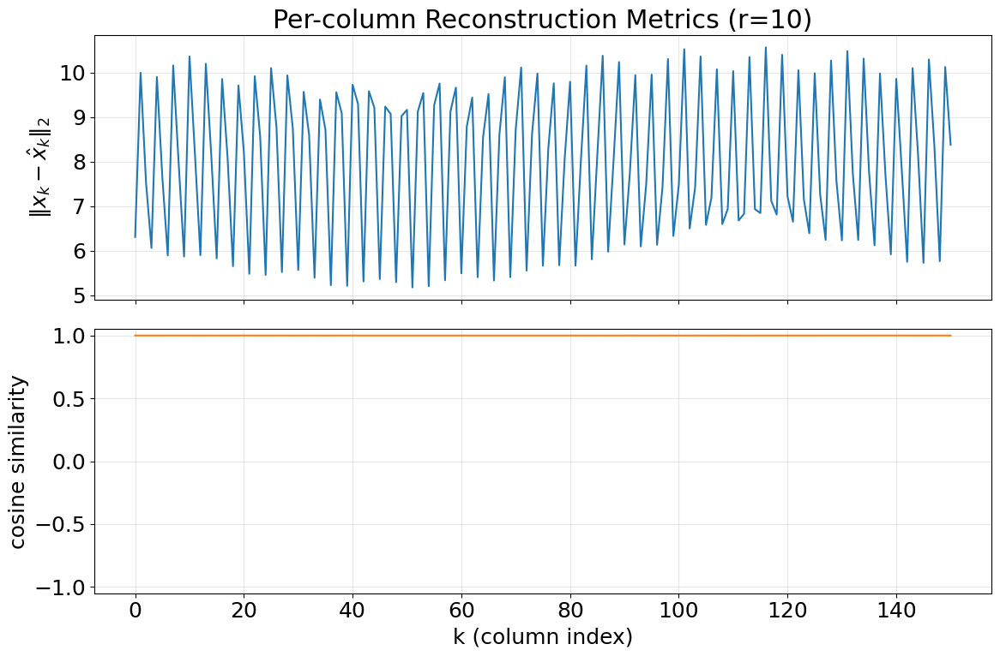

In [7]:
# Plot norm difference and cosine similarity by column index k
k_idx = np.arange(vortices.shape[1])

fig, axes = plt.subplots(2, 1, figsize=(12, 8), sharex=True)

# Norm difference: ||x_k - x_hat_k||_2
axes[0].plot(k_idx, diff_norms, color='tab:blue', linewidth=1.5)
axes[0].set_ylabel(r'$\|x_k - \hat{x}_k\|_2$')
axes[0].set_title(f'Per-column Reconstruction Metrics (r={r})')
axes[0].grid(True, alpha=0.3)

# Cosine similarity
axes[1].plot(k_idx, cos_sims, color='tab:orange', linewidth=1.5)
axes[1].set_xlabel('k (column index)')
axes[1].set_ylabel('cosine similarity')
axes[1].set_ylim(-1.05, 1.05)
axes[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

In [8]:
# Build W_m_1 and W_m_2 from shifted columns of W
# W_m_1: columns 0 to (last-1), W_m_2: columns 1 to last
num_cols = W.shape[1]

W_m_1 = W[:, 0:num_cols-1]
W_m_2 = W[:, 1:num_cols]

print("W shape   :", W.shape)
print("W_m_1 shape:", W_m_1.shape)
print("W_m_2 shape:", W_m_2.shape)

# SVD of W_m_1
U_w, S_w, VT_w = np.linalg.svd(W_m_1, full_matrices=False)

# Pseudo-inverse of W_m_1 using its SVD
tol = 1e-12
S_w_inv = np.array([1/s if s > tol else 0.0 for s in S_w])
W_m_1_pinv = VT_w.T @ np.diag(S_w_inv) @ U_w.T

print("U_w shape       :", U_w.shape)
print("S_w shape       :", S_w.shape)
print("VT_w shape      :", VT_w.shape)
print("W_m_1_pinv shape:", W_m_1_pinv.shape)

# Optional check: compare with numpy pinv
pinv_diff = np.linalg.norm(W_m_1_pinv - np.linalg.pinv(W_m_1), ord='fro')
print(f"||W_m_1_pinv - np.linalg.pinv(W_m_1)||_F = {pinv_diff:.3e}")

W shape   : (10, 151)
W_m_1 shape: (10, 150)
W_m_2 shape: (10, 150)
U_w shape       : (10, 10)
S_w shape       : (10,)
VT_w shape      : (10, 150)
W_m_1_pinv shape: (150, 10)
||W_m_1_pinv - np.linalg.pinv(W_m_1)||_F = 1.456e-18


A shape: (10, 10)
eigenvecs.shape =  (10, 10)
Number of eigenvalues: 10
First few eigenvalues:
lambda_0 = 0.673738 + 0.738940j
lambda_1 = 0.673738 + -0.738940j
lambda_2 = 0.500432 + 0.000000j
lambda_3 = 1.000000 + 0.000000j
lambda_4 = 0.811628 + 0.583930j
lambda_5 = 0.811628 + -0.583930j
lambda_6 = 0.978482 + 0.206359j
lambda_7 = 0.978482 + -0.206359j
lambda_8 = 0.914836 + 0.403819j
lambda_9 = 0.914836 + -0.403819j


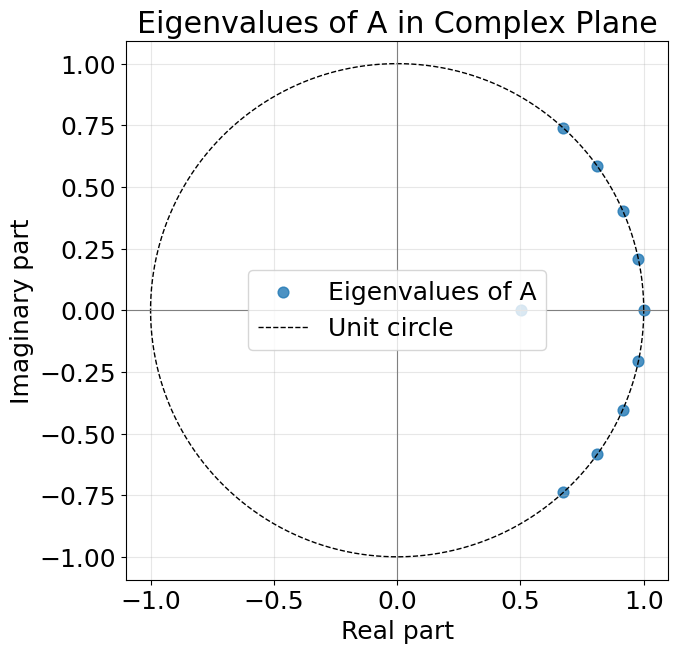

In [22]:
# Solve W_m_2 = A W_m_1 for A using pseudo-inverse
# (least-squares / minimum-norm solution)
A = W_m_2 @ W_m_1_pinv

print("A shape:", A.shape)

# Eigen-decomposition of A
eigvals, eigvecs = np.linalg.eig(A)

print( "eigenvecs.shape = ", eigvecs.shape  )
print("Number of eigenvalues:", eigvals.shape[0])
print("First few eigenvalues:")
for i, lam in enumerate(eigvals[:min(10, len(eigvals))]):
    print(f"lambda_{i} = {lam.real:.6f} + {lam.imag:.6f}j")

# Plot eigenvalues in complex plane
plt.figure(figsize=(7, 7))
plt.scatter(eigvals.real, eigvals.imag, s=60, alpha=0.8, label='Eigenvalues of A')

# Optional reference: unit circle
theta = np.linspace(0, 2*np.pi, 400)
plt.plot(np.cos(theta), np.sin(theta), 'k--', linewidth=1, label='Unit circle')

plt.axhline(0, color='gray', linewidth=0.8)
plt.axvline(0, color='gray', linewidth=0.8)
plt.xlabel('Real part')
plt.ylabel('Imaginary part')
plt.title('Eigenvalues of A in Complex Plane')
plt.axis('equal')
plt.grid(True, alpha=0.3)
plt.legend()
plt.show()


For a real-valued matrix \(A\):

$$
A \in \mathbb{R}^{n\times n}
$$

- Any **non-real** eigenvalue must appear with its complex conjugate.
- But \(A\) can also have **real** eigenvalues.

So the spectrum is generally:

$$
\{\lambda_1,\dots,\lambda_n\}
=
\{\text{real eigenvalues}\}
\;\cup\;
\{\mu_1,\overline{\mu_1},\mu_2,\overline{\mu_2},\dots\}.
$$

Example: a real \(3\times 3\) matrix could have eigenvalues

$$
\{2,\;0.7+0.4i,\;0.7-0.4i\}.
$$

So: **complex ones come in conjugate pairs, but not all eigenvalues must be complex (can be real valued).**


$$
\widetilde{W} = A W
\quad\Longrightarrow\quad
A = \widetilde{W}\,W^{\dagger}
$$

where $W^{\dagger}$ is the Moore–Penrose pseudoinverse.

If $W$ is square and invertible, this reduces to:

$$
A = \widetilde{W}\,W^{-1}
$$

In your time-shifted setup (DMD-style), with:

$$
W_{m,1} = [w_0,\dots,w_{m-2}],\qquad
W_{m,2} = [w_1,\dots,w_{m-1}],
$$

you use:

$$
A = W_{m,2}\,W_{m,1}^{\dagger},
$$

which gives the best-fit linear map for:

$$
w_{k+1} \approx A w_k.
$$


An eigenvector/eigenvalue pair is defined by:
$$
A v = \lambda v,
\qquad
v \neq 0.
$$

This means applying the matrix keeps the direction (or mode) and only changes it by a scalar factor:
$$
v \;\mapsto\; \lambda v.
$$

For discrete-time dynamics:
$$
x_{k+1} = A x_k,
$$
if the state is expanded in eigenvectors, each mode evolves independently like:
$$
c_{k+1}^{(j)} = \lambda_j c_k^{(j)}.
$$

Magnitude interpretation:
$$
|\lambda_j| > 1 \Rightarrow \text{growth},
\qquad
|\lambda_j| < 1 \Rightarrow \text{decay},
\qquad
|\lambda_j| = 1 \Rightarrow \text{constant amplitude}.
$$

If the eigenvalue is complex:
$$
\lambda_j = r e^{i\theta},
$$
then:
$$
r = |\lambda_j| \quad \text{controls growth/decay},
\qquad
\theta = \arg(\lambda_j) \quad \text{controls oscillation/rotation per step}.
$$

For your reduced model:
$$
W_{m,2} \approx A W_{m,1},
$$
so:
$$
w_{k+1} \approx A w_k,
$$
which means \(A\) is the one-step propagator in modal coordinates.

In [10]:
# Reconstruct W by iterating A forward from w_0
W_reconstructed = np.zeros_like(W)
W_reconstructed[:, 0] = W[:, 0]  # Initial condition

for k in range(W.shape[1] - 1):
    W_reconstructed[:, k+1] = A @ W_reconstructed[:, k]

# Compare with original W
reconstruction_error = np.linalg.norm(W - W_reconstructed, ord='fro')
print(f"||W - W_reconstructed||_F = {reconstruction_error:.6e}")

# Relative error
relative_error = reconstruction_error / np.linalg.norm(W, ord='fro')
print(f"Relative Frobenius error = {relative_error:.6e}")

||W - W_reconstructed||_F = 7.796180e+01
Relative Frobenius error = 1.899109e-02


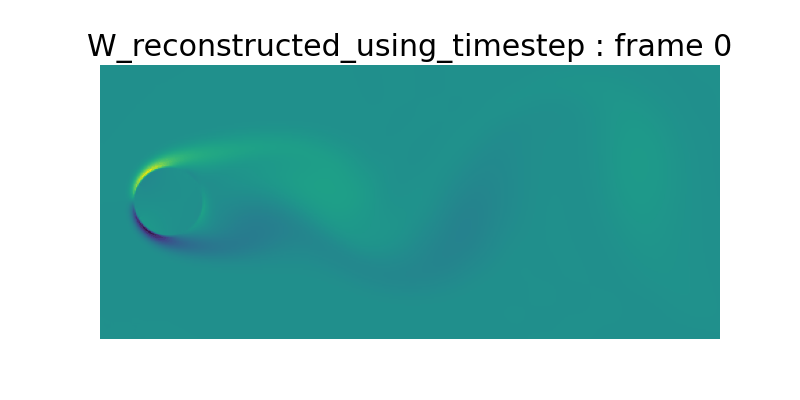

In [16]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import Image, display

# Rebuild full-state snapshots from reconstructed W
# W_reconstructed shape: (r, n_frames)
# U_tilde shape: (n_space, r)
X_reconstructed = U_tilde @ W_reconstructed
X_reconstructed = np.real_if_close(X_reconstructed)  # safety if tiny complex parts appear

# Movie settings (same as earlier)
m_display, n_display = 199, 449
num_frames = X_reconstructed.shape[1]
fps = 23
output_path = "vortices_from_W_reconstructed.gif"

# Keep color scale consistent (optional: use vortices min/max for fair comparison)
vmin = vortices.min()
vmax = vortices.max()

fig, ax = plt.subplots(figsize=(8, 4))
frame0 = X_reconstructed[:, 0].reshape((m_display, n_display), order="F")
im = ax.imshow(frame0, cmap="viridis", vmin=vmin, vmax=vmax)
ax.set_title("W_reconstructed_using_timestep : frame 0")
ax.axis("off")

def update(frame_idx):
    frame = X_reconstructed[:, frame_idx].reshape((m_display, n_display), order="F")
    im.set_data(frame)
    ax.set_title(f"W_reconstructed_using_timestep : frame {frame_idx}")
    return (im,)

anim = animation.FuncAnimation(
    fig, update, frames=num_frames, interval=1000 / fps, blit=True
)
anim.save(output_path, writer="pillow", fps=fps)
plt.close(fig)

display(Image(filename=output_path))

Notice, how the kth element of w, w_k = A^{k-1} w_1

$$
w_{k+1} = A w_k
$$

Starting from index \(1\):

$$
w_1 = A^0 w_1
$$

$$
w_2 = A^1 w_1 = A w_1
$$

$$
w_3 = A^2 w_1 = A(Aw_1)
$$

In general:

$$
w_k = A^{k-1} w_1
$$

with:

$$
A^0 = I
$$

where \(I\) is the identity matrix.

For your reconstructed flow field in full space:

$$
x_k \approx U_{\tilde{}}\, w_k
$$

so predicted snapshots are:

$$
x_k^{\text{pred}} \approx U_{\tilde{}}\, A^{k-1} w_1
$$

And in stacked matrix form (1-based columns):

$$
W_{\text{pred}} = \left[\, w_1,\; Aw_1,\; A^2w_1,\;\dots,\;A^{m-1}w_1 \,\right].
$$

||W - W_reconstructed_power||_F = 7.796180e+01
Relative error                = 1.899109e-02


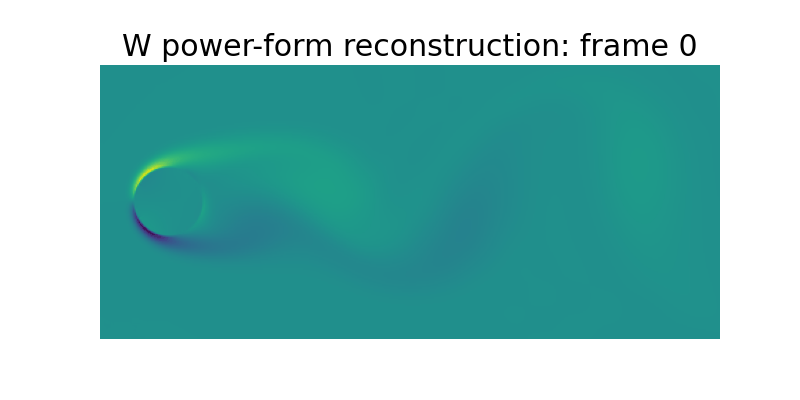

In [20]:
# Reconstruct W using power form: w_k = A^k w_1 (0-based k), then recreate movie
# Assumes A, W, U_tilde, vortices are already defined from earlier cells.

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import Image, display

# -------------------------
# 1) Power-form reconstruction of W
# -------------------------
w1 = W[:, 0].astype(complex)   # this is w_1 in 1-based notation
r = A.shape[0]
n_steps = W.shape[1]

W_reconstructed_power = np.zeros((r, n_steps), dtype=complex)
for k in range(n_steps):
    W_reconstructed_power[:, k] = np.linalg.matrix_power(A, k) @ w1

# Optional: keep real part if tiny imaginary roundoff exists
W_reconstructed_power = np.real_if_close(W_reconstructed_power)

# Compare with original W
abs_err = np.linalg.norm(W - W_reconstructed_power, ord='fro')
rel_err = abs_err / (np.linalg.norm(W, ord='fro') + 1e-16)
print(f"||W - W_reconstructed_power||_F = {abs_err:.6e}")
print(f"Relative error                = {rel_err:.6e}")

# -------------------------
# 2) Reconstruct full flow field X from W
# -------------------------
X_reconstructed_power = U_tilde @ W_reconstructed_power
X_reconstructed_power = np.real_if_close(X_reconstructed_power)

# -------------------------
# 3) Create movie
# -------------------------
m_display, n_display = 199, 449
fps = 23
num_frames = X_reconstructed_power.shape[1]
output_path = "vortices_from_W_power.gif"

# Keep color scale consistent with true data for fair visual comparison
vmin = vortices.min()
vmax = vortices.max()

fig, ax = plt.subplots(figsize=(8, 4))
frame0 = X_reconstructed_power[:, 0].reshape((m_display, n_display), order="F")
im = ax.imshow(frame0, cmap="viridis", vmin=vmin, vmax=vmax)
ax.set_title("W power-form reconstruction: frame 0")
ax.axis("off")

def update(frame_idx):
    frame = X_reconstructed_power[:, frame_idx].reshape((m_display, n_display), order="F")
    im.set_data(frame)
    ax.set_title(f"W power-form reconstruction: frame {frame_idx}")
    return (im,)

anim = animation.FuncAnimation(
    fig, update, frames=num_frames, interval=1000 / fps, blit=True
)
anim.save(output_path, writer="pillow", fps=fps)
plt.close(fig)

display(Image(filename=output_path))